# Systems Thinking and Dynamical Systems

A dynamic system is a system whose current state generates its successive state by a rule or principle of change (the so-called evolution rule) and thus produces a trajectory in state space.  All physical reality can be modeled in this way. 

## The Anatomy of Modeling Reality

For each instance of time, the change in the state of an observation (air particle) with respect to time is referred to as the particle's dynamics. For each instance of time, the particle's expected rate of change ($dx/dt$) is calculated as a function ($f$) of its state ($x$), time ($t$), the variables of control ($u$), and variables that cannot be controlled ($β$). In abstract, $dx/dt = f(x, t, u; β)$.

Finally, the state of an observable is not always as simple as the x, y, z coordinates in a 3D plane, as with our air particle example for Lorenz.  Think of observed states of a brain, or perhaps an observed state of something really big.  We have to think of an objective way to measure the state.  We'll abstract these measurements as $y$, equal to a function of the state and time $g(x, t)$ give or take any error, or noise ($n$) while measuring.  In abstract, $y= g(x,t) + n$.


# Systems Thinking on the Job

I was first exposed to the concepts of systems thinking by way of learning project management methodologies (namely the Agile Method, the Lean practice, and devOps)  for carrying out strategic initiatives within the workplace.

In devOps, developers and human operators are represented as instances, or observations of individuals, who implement tech-driven solutions to resolve the goals of operations' side stakeholders.  The system in which this is done is a closed loop.  The instances of individuals have various goals.  These conflicting goals and politicized views can make the process of bringing ideation to product (sometimes said as "development to production") inefficent or downright impossible.  

To engineer an efficient system of production deployment, devOps professionals modify the system environment to enhance the free flow of system actors to accomplish their goals in a continuous closed loop.  In other words, they speed up or optimize the process of ideation to product.

I am familiar with these practices from my experience at a tech company called DXC and a healthcare organization called Change Healthcare.  I worked at Deloitte, as well.  Although several business leaders at Deloitte assured me that their organization had bought into these practices, I found them agile in name only.  The initial conditions of this environment were heavily influenced by highly matrixed implementation partners from overseas.  They were agile in powerpoint presentation buzzwords, but not in practice.  On the contrary, they were quite averse to the idea.  

I quietly thought this must be to optimize and maximize the base rate billed to the client.  Is no one at Deloitte incentivized to build an efficient product delivery closed loop system?  I never understood this.  As a consultant, agile practices should equate to a amplified feedback loop, such that a perpetual consultant-client relationship forms naturally.

I no longer work at Deloitte.  During my time, I made zero connections, I learned zero valuable skills.  I was presented with zero projects I found interesting or related to the contributions I offer.  I wonder if I could have done a better job at communicating my point of view, but at any rate, I mainly felt pushed to the side within a king's court that I was not comfortable navigating.  I didn't feel that anyone valued my point of view on how implementation should be designed during planning.  I got pretty tired of people telling me to jump in sharepoint to contribute to have all of my work replaced by someone else's authorship every time I would commit changes with no lineage documented.  Teams I worked on, rejected using simple tools like git that are commonly used.  I was erased from history, in this way.  

I like to work with others in person.  I think this work-from-home stuff has ruined my ability to navigate organizational complexity.  I like spending a headachey Monday on the couch instead of the cubicle as much as the next guy, but sometimes I think it worked better knowing the rest of the company was still in a building somewhere, regardless of my location.  Selfish, I know.

So, what?  Who cares?  Not me, back to dynamic systems.  I'm new to the idea of modeling them, so I thought I'd give it a shot with a classic problem: modeling the chaotic dynamic system referred to as the Lorenz system.  The idea here is to gain a little muscle memory around piecing together the components of a classic dynamic system, to ultimately become more confident at modeling industrial or business dynamics.  Got to start somewhere, yea?  Let's go!

# The Lorenz System

The Lorenz System describes the chaotic behavior of observables or instances.  In this case, these observables represent particles in a weather system.  Given initial conditions with minute variation, the outcome of these particles although deterministic can wildly vary.  This is referred to as chaotic.

> Edward Lorenz, the father of chaos theory, once described chaos as “when the present determines the future, but the approximate present does not approximately determine the future.”

> Lorenz first discovered chaos by accident while developing a simple mathematical model of atmospheric convection, using three ordinary differential equations. He found that nearly indistinguishable initial conditions could produce completely divergent outcomes, rendering weather prediction impossible beyond a time horizon of about a fortnight.

To model the system, Lorenz models the change in the 3D coordinates with respect to time as $dx/dt = σ(y - x)$, $dy/dt = x(ρ - z) - y$, and $dz/dt = xy - βz$.  This is a system of differential equations we'll implement to determine an air particle's next position.

Check out an [article](https://geoffboeing.com/2016/12/animating-lorenz-attractor-python/#:~:text=Now%20known%20as%20the%20Lorenz,to%20create%20the%20animated%20GIF.) I referenced from Geoff Boeing for my source of ideation.  Check out a [youtube video](https://www.youtube.com/watch?v=-FvrON0OmYc) from Steve Brunton which highlights the objectives we have in working with these systems.  Also, check out this [youtube video](https://www.youtube.com/watch?v=TRsQrvP4xKI) clip of a popular sitcom, which highlights the importance of Lorenz' findings.  

Who needs a degree, when you have videos from the internet and a big ego, eh?  Grow up, recruiters!  We live in an age where all knowledge is accessible to those who are willing to do a google search and commit their time.


## Implementation

Why reinvent the wheel? I find it useful to look to openly available repositories of code for inspiration.  We'll implement code sourced from and inspired by Geoff Boeing's repository of code, [Lorenz-System](https://github.com/gboeing/lorenz-system).

If you hired a plumber for a thousand bucks and he spent a couple of days at your place to fix the john, you might could feel like your getting your money's worth based on the work duration.  If that plumber's boss came through he'd still charge you a thousand bucks, but it would only take 5 minutes.  So what are you paying for?  A solution, or an opportunity to spend a couple days with a plumber.  Perceived value is interesting.  

Some folks might take offense to someone using another person's code.  I feel this is backward thinking, perhaps I'm biased.  I rely on sourcing code from an open community.  Someday in the future, being paid for writing code may be a thing of the past.  I've made a lot of dough from copying and pasting, since way back to excel days.  The trick is knowing what to copy and paste, a skill a bit more complex than one might imagine.

For the sake of the IP police, I rewrote Boeing's [stuff](https://github.com/gboeing/lorenz-system/blob/master/lorenz-system-attractor-animate.ipynb) as below.

In [ ]:
%matplotlib inline
import numpy as np, matplotlib.pyplot as plt, glob, os
import IPython.display as IPdisplay, matplotlib.font_manager as fm
from scipy.integrate import odeint
from mpl_toolkits.mplot3d.axes3d import Axes3D
from PIL import Image

In [ ]:
# folder directory to save animation images
imgPath = 'img'

# initial conditions of the system
x_0 = [.1, 0, 0] # initial x, y, z coordinate position
u = {'sigma': 10,
     'rho': 28}
beta = 8./3.

# time points
s = 1
e = 60
interval = 100
timePoints = np.linspace(s, e, e * interval)

# define the fonts to use for plots
family = 'serif'
titleFont = fm.FontProperties(family=family, style='normal', size=20, weight='normal', stretch='normal')

In [ ]:
 def getDerivatives(x, t):
  xCoord, yCoord, zCoord = x
  dxdt = u['sigma'] * (yCoord - xCoord)
  dydt = xCoord * (u['rho'] - zCoord) - yCoord
  dzdt = xCoord * yCoord - beta * zCoord
  return [dxdt, dydt, dzdt]

In [ ]:
def plotLorenzPNG(pos, idx):
    fig = plt.figure(figsize=(12, 9))
    ax = fig.gca(projection='3d')
    ax.xaxis.set_pane_color((1,1,1,1))
    ax.yaxis.set_pane_color((1,1,1,1))
    ax.zaxis.set_pane_color((1,1,1,1))
    x = pos[:, 0]
    y = pos[:, 1]
    z = pos[:, 2]
    ax.plot(x, y, z, color='b', alpha=0.7, linewidth=0.7)
    ax.set_xlim((-30,30))
    ax.set_ylim((-30,30))
    ax.set_zlim((0,50))
    ax.set_title('Lorenz system attractor', fontproperties=titleFont)
    
    plt.savefig('{}/{:03d}.png'.format(imgPath, idx), dpi=60, bbox_inches='tight', pad_inches=0.1)
    plt.close()

In [ ]:
def getPartialTimePointsLi(timePointLi, size=20):
  size = max(1, size)
  chunks = []
  for i in range(1, len(timePointLi) + 1, size):
    chunks.append(timePointLi[0:i])
  return chunks

In [ ]:
# save each animation frame as png
chunks = getPartialTimePointsLi(timePoints)

In [ ]:
points = []
for li in chunks:
  points.append(odeint(getDerivatives, x_0, li))

In [ ]:
for i, point in enumerate(points):
  plotLorenzPNG(point, i)

## Animation

In [ ]:
# initiate animation parameters
firstLast = 10000 # ms duration for the first and last images
standard = 500 # ms
durations = tuple([firstLast] + [standard]* (len(points) - 2) + [firstLast])
gifName = '/animation.gif'

# extract all the png files to an in memory list
files = []
for file in glob.glob('{}/*.png'.format(imgPath)):
  files.append(Image.open(file))

# load list to animated .gif file
gif = files[0]
gif.info['duration'] = durations
gif.info['loop'] = 0 # 0 results in infinite loops
gif.save(fp=imgPath+gifName, format='gif', save_all=True, append_images=files[1:])

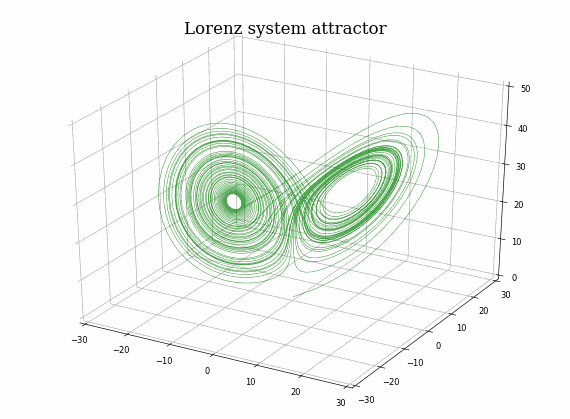

In [ ]:
IPdisplay.Image(open(imgPath+gifName, 'rb').read())

# Conclusion
I approach learning new ideas and skills for work, somewhat like an investor, but I digress as I am still tapping my feet for the payoff!

About seven years ago as a data analyst, I couldn't shut up about PowerBI and reporting services at large.  I didn't have a very big audience that was attentive. Five years later, the only jobs they would bring to me were in regards to PowerBI.  Of course, I had moved on to more exciting things by then. Machine Learning became my main interest.  How do we teach a computer to make predictions and more importantly for my line of work, what does the predictive model say about how we should approach changing the current state of a business process to achieve a favorable outcome.  This is after all, the entropy or information that the business needs revealing.  

I still can't shut up about machine learning, but like with PowerBI the adoption of the job market has not caught up yet.  Like with PowerBI, the market from my point of view does not yet understand what to do with machine learning: opportunities abound.  The market adopts later than I.  In this way, I am early to adopt to trends.

Today, I know that machine learning is often used to discover the optimal function to describe a dynamic system, or the ideal parameter set of initial conditions to achieve a favorable outcome in a given system.  I wonder if I'll start receiving more opportunities in machine learning as I drift away into other topics, like designing the formal specifications for how to control dynamic systems. 

One day, I'll have to stop "pioneering" and sit down to cash out. At age 35, I am still in a stage of life where I have yet to experience any success.  I have not secured any financial assets or property that I see as necessary for integrating into society.  The grumpy, ego-centric, math nerd with a strange sense of humor deserves a place, too.  Maybe there's another way.  Today, I sit with those who execute for today.  Maybe I should sit where they plan for tomorrow.  I don't know. I am still trying to figure it out.

Today, it is trendy to secure employees for an organization in the name of diversity.  Let's make sure we have a certain number of minorities in proportion to the whole.  I ask, what about people like me who are just smart, sometimes not warm and fuzzy to be around?  These attributes describe all of my favorite people.  To me, this is desirable. 

That's my personality.  I am in the minority, but I don't to be a part of any diversity program.  Is there a priority to retain grumpy, smart, reclusive talent? Is it appropriate for the workplace to propose that I change my personality to fit in better at work? I can only be myself.  I don't want to assimilate.  I love my personality.

Shifts in these ideas are a fashion or fad.  I am introverted.  I enjoy my time alone.  You might say I am not a team player.  I disagree.  I add value to my team in different ways than the majority of individuals.  I need to identify a project that provides an environment for my success.  In the past, when I recognize that the environment I found myself in at work is not one in which I can succeed, I begin plans to checkout.

Does your place of business provide exceptions where unassimilated individuals can succeed?  If I am unwilling to assimilate, the only other option seems to be an exit.  I don't want to exit, beit a fair and inviting trade-off.

Perhaps there is a way to change the initial conditions, in order to understand at which time my status will change, such that I can reach my goals in serving others without sacrificing who I am.

Sound familiar?  I like the idea of systems-thinking. Knock-knock.  Who's there? Dynamical systems? Hello, world.